#Unit Testing\n
Module 5 of the Course is migrated to a Jupyter notebook so it won't be messy in the file. Code examples, definitions will be defined here. Debating whether separate programs for this module will be added here as well or be created in a different file.

Note: Screenshots don't have to be declared or added to the folder before being used here. Pasting it, after screenshots work immediately.

(Just in case)
Files included in the module:
- C2M5L2_Unit_Tests_and_Edge_Cases-V3.ipynb

# Software testing

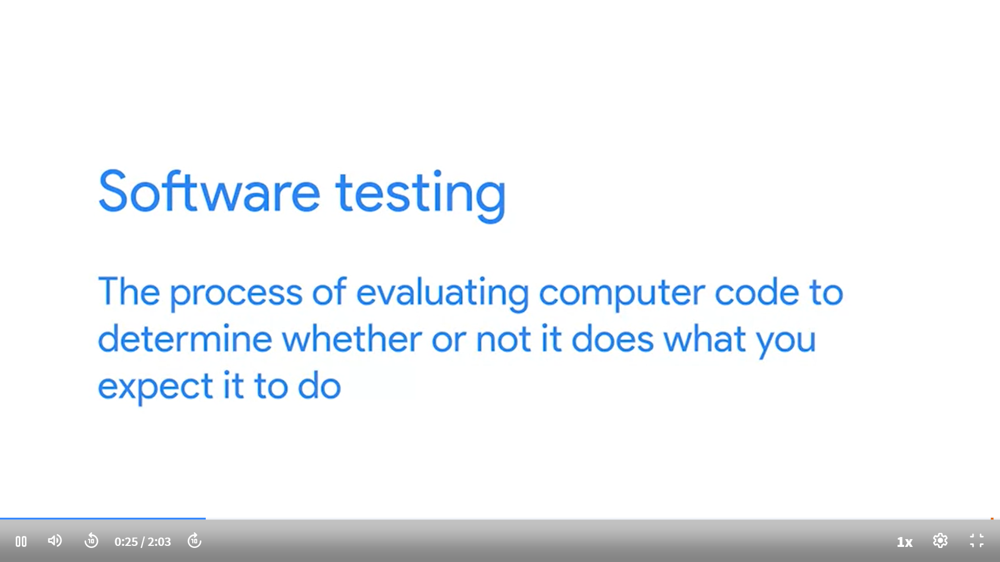
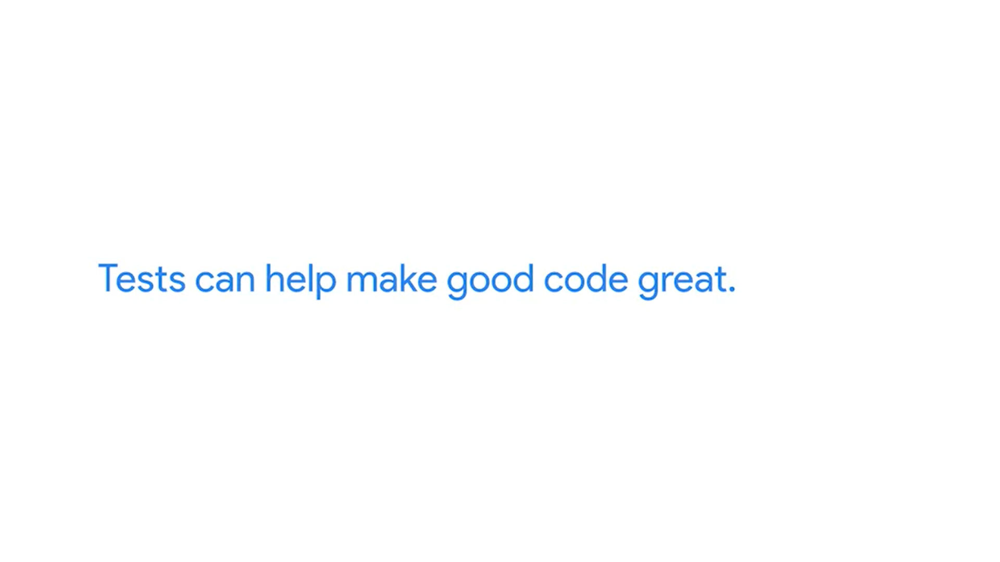

Types of Testing
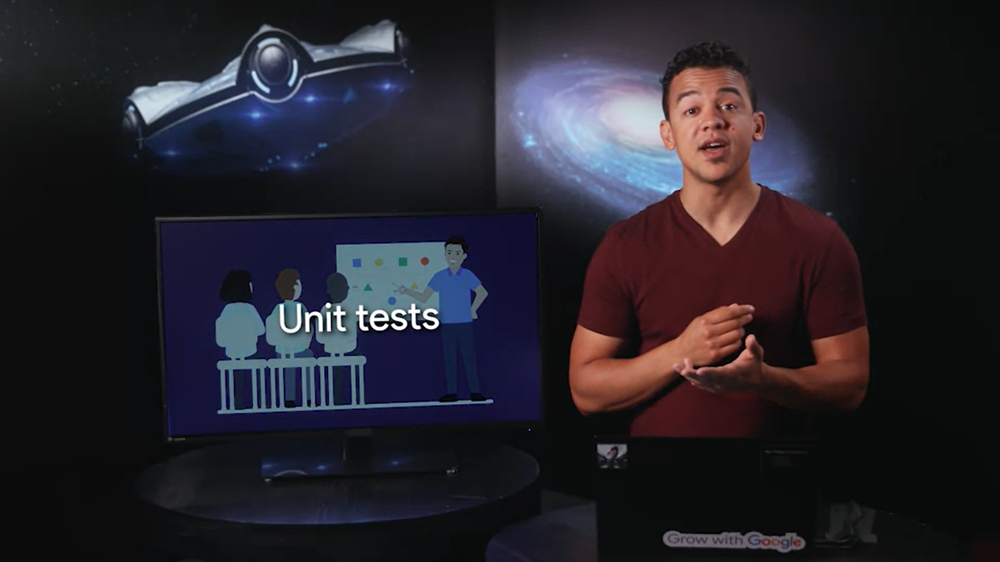
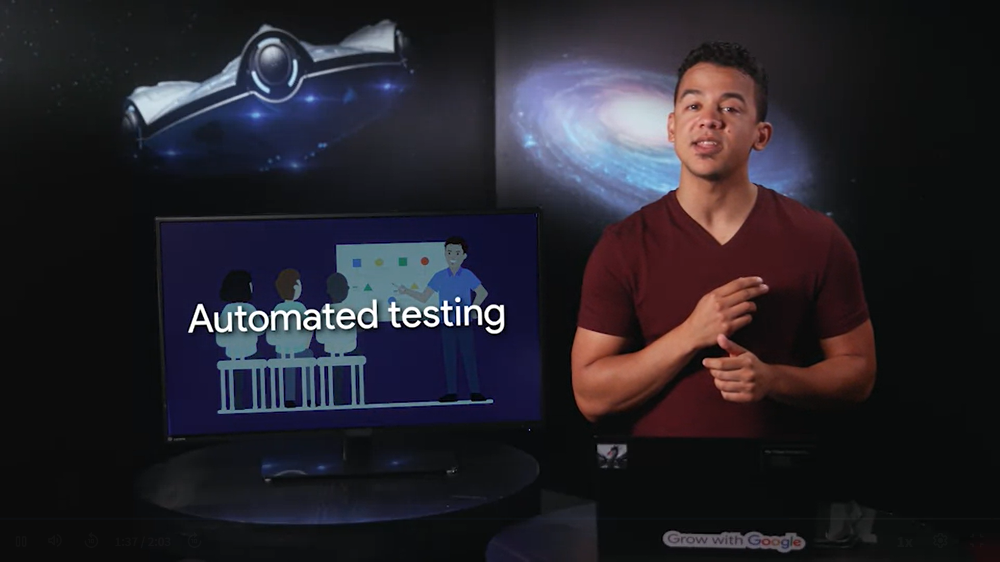
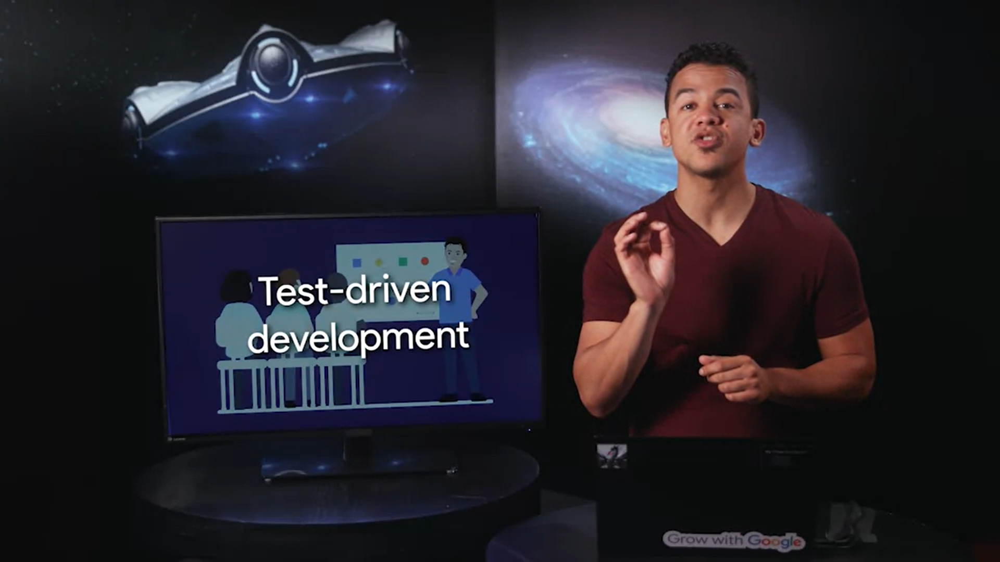

Test Cases
Automated Testing
 - is a software testing method where the software is tested with the help of a specialized software.
 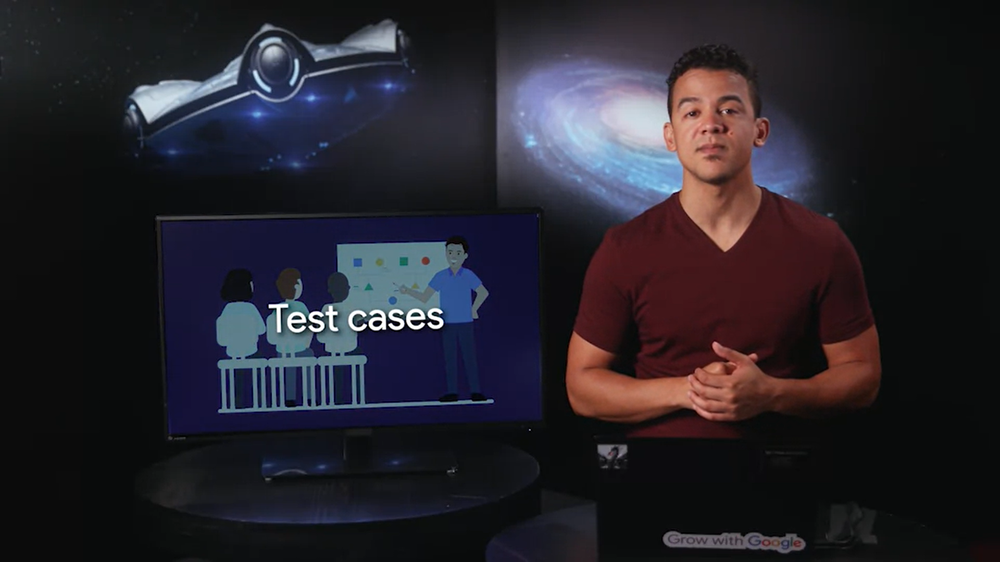
 - We'll concentrate on UNIT TESTING

## Unit Tests

### Use case
Let’s look at a test case example where the Python code simulates a cake factory and performs different functions. These include choosing different sizes and flavors of a cake, including small, medium, and large, and chocolate or vanilla. In addition, the simple class allows developers to add sprinkles or cherries to the cake, return a list of ingredients, and return the price of the cake based on size and toppings. Run the following code: 

In [1]:
from typing import List


class CakeFactory:
 def __init__(self, cake_type: str, size: str):
   self.cake_type = cake_type
   self.size = size
   self.toppings = []

   # Price based on cake type and size
   self.price = 10 if self.cake_type == "chocolate" else 8
   self.price += 2 if self.size == "medium" else 4 if self.size == "large" else 0

 def add_topping(self, topping: str):
     self.toppings.append(topping)
     # Adding 1 to the price for each topping
     self.price += 1

 def check_ingredients(self) -> List[str]:
     ingredients = ['flour', 'sugar', 'eggs']
     ingredients.append('cocoa') if self.cake_type == "chocolate" else ingredients.append('vanilla extract')
     ingredients += self.toppings
     return ingredients

 def check_price(self) -> float:
     return self.price

# Example of creating a cake and adding toppings
cake = CakeFactory("chocolate", "medium")
cake.add_topping("sprinkles")
cake.add_topping("cherries")
cake_ingredients = cake.check_ingredients()
cake_price = cake.check_price()


cake_ingredients, cake_price

(['flour', 'sugar', 'eggs', 'cocoa', 'sprinkles', 'cherries'], 14)

In the code above, the cake factory class and methods are defined. Now it’s time to define the unittest methods to test the different functions of the code. The test suite includes tests for the cake’s flavor, size, toppings, ingredients, and price. The first test case in the suite will intentionally provide the wrong value—and that’s what we want! Create specific statements to make sure the program is behaving as it should. That includes providing incorrect data to determine if the program will provide failed results. Because unittest is class-based,  encapsulate these statements into test methods. 

In [2]:
import unittest

class TestCakeFactory(unittest.TestCase):
 def test_create_cake(self):
   cake = CakeFactory("vanilla", "small")
   self.assertEqual(cake.cake_type, "vanilla")
   self.assertEqual(cake.size, "small")
   self.assertEqual(cake.price, 8) # Vanilla cake, small size

 def test_add_topping(self):
     cake = CakeFactory("chocolate", "large")
     cake.add_topping("sprinkles")
     self.assertIn("sprinkles", cake.toppings)

 def test_check_ingredients(self):
     cake = CakeFactory("chocolate", "medium")
     cake.add_topping("cherries")
     ingredients = cake.check_ingredients()
     self.assertIn("cocoa", ingredients)
     self.assertIn("cherries", ingredients)
     self.assertNotIn("vanilla extract", ingredients)

 def test_check_price(self):
     cake = CakeFactory("vanilla", "large")
     cake.add_topping("sprinkles")
     cake.add_topping("cherries")
     price = cake.check_price()
     self.assertEqual(price, 13) # Vanilla cake, large size + 2 toppings


# Running the unittests
unittest.TextTestRunner().run(unittest.TestLoader().loadTestsFromTestCase(TestCakeFactory))

..F.
FAIL: test_check_price (__main__.TestCakeFactory.test_check_price)
----------------------------------------------------------------------
Traceback (most recent call last):
  File "C:\Users\pattd\AppData\Local\Temp\ipykernel_4208\1129695515.py", line 28, in test_check_price
    self.assertEqual(price, 13) # Vanilla cake, large size + 2 toppings
    ~~~~~~~~~~~~~~~~^^^^^^^^^^^
AssertionError: 14 != 13

----------------------------------------------------------------------
Ran 4 tests in 0.008s

FAILED (failures=1)


<unittest.runner.TextTestResult run=4 errors=0 failures=1>

The program calls the TextTestRunner() method, which returns a runner (TextTestResult). It says one failure occurred: the statement self.assertEqual(price, 13) was incorrect, as it should have been 14. How can we correct that part of the test? Update that part of the code to the following:

In [3]:
import unittest


# Fixing the test_check_price method
class TestCakeFactory(unittest.TestCase):
 # ... Other tests remain the same

 def test_check_price(self):
     cake = CakeFactory("vanilla", "large")
     cake.add_topping("sprinkles")
     cake.add_topping("cherries")
     price = cake.check_price()
     self.assertEqual(price, 14) # Vanilla cake, large size + 2 toppings

# Re-running the unittests
unittest.TextTestRunner().run(unittest.TestLoader().loadTestsFromTestCase(TestCakeFactory))

.
----------------------------------------------------------------------
Ran 1 test in 0.001s

OK


<unittest.runner.TextTestResult run=1 errors=0 failures=0>

### pytest
Pytest is a powerful Python testing tool that assists programmers in writing more effective and stable programs. It helps to simplify the process of writing, organizing and executing tests. It can be used to write a variety of tests including: integration, end-to-end, and functional tests. It supports automatic test discovery and generates informative test reports. 

In this reading, you will learn more about pytests, how to write tests with pytest, and its fixtures.

How to write tests
Pytests are written with functions that use the operation, assert(). An assert is a commonly used debugging tool in Python that allows programmers to include sanity checks in their code. They ensure certain conditions or assumptions hold true during runtime. If the condition provided to assert() turns out to be false, it indicates a bug in the code, an exception is raised, and halts the program’s execution. Typically, code provides an assert condition followed by an optional message. An example is: 

In [4]:
def divide(a, b):
	assert b != 0, "Cannot divide by zero"
	return a / b

An AssertionError message is raised informing the programmer that it is not possible to divide a value by zero.

### Pytest fixtures
Fixtures are used to separate parts of code that only run for tests. They are reusable pieces of test setups and teardown code that are shared across multiple tests. Fixtures benefit developers by assisting in keeping their tests clean and avoiding code duplication. Let’s look at an example of using a pytest in Python:

In [ ]:
# DO NOT RUN THIS CODE
# This cell is for reference only.

import pytest
class Fruit:
    def __init__(self, name):
        self.name = name
        self.cubed = False


    def cube(self):
        self.cubed = True


class FruitSalad:
    def __init__(self, *fruit_bowl):
        self.fruit = fruit_bowl
        self._cube_fruit()


    def _cube_fruit(self):
        for fruit in self.fruit:
            fruit.cube()


# Arrange
@pytest.fixture
def fruit_bowl():
    return [Fruit("apple"), Fruit("banana")]


def test_fruit_salad(fruit_bowl):
    # Act
    fruit_salad = FruitSalad(*fruit_bowl)


    # Assert
    assert all(fruit.cubed for fruit in fruit_salad.fruit)

### Comparing unittest and pytest
Both unittest and pytest provide developers with tools to create robust and reliable code through different forms of tests. Both can be used while creating programs within Python, and it is the developer’s preference on which type they want to use.

In this reading, you will learn about the differences between unittest and pytest, and when to use them.

Key differences
Unittest is a tool that is built directly into Python, while pytest must be imported from outside your script. Test discovery acts differently for each test type. Unittest has the functionality to automatically detect test cases within an application, but it must be called from the command line. Pytests are performed automatically using the prefix test_. Unittests use an object-oriented approach to write tests, while pytests use a functional approach. Pytests use built-in assert statements, making tests easier to read and write. On the other hand, unittests provide special assert methods like assertEqual() or assertTrue().

Backward compatibility exists between unittest and pytest. Because unittest is built directly into Python, these test suites are more easily executed. But that doesn’t mean that pytest cannot be executed. Because of backward compatibility, the unittest framework can be seamlessly executed using the pytest framework without major modifications. This allows developers to adopt pytest gradually and integrate them into their code.

Key takeaways
Unittest and pytest are both beneficial to developers in executing tests on their code written in Python. Each one has its pros and cons, and it is up to the developer and their preference on which type of testing framework they want to use. 



#### Review: Unit tests
This reading contains the code used in the instructional videos from 
Unit Tests

Introduction
This follow-along reading is organized to match the content in the video that follows. It contains the same code shown in the next video. These code blocks will provide you with the opportunity to see how the code is written, allow you to practice running it, and can be used as a reference to refer back to. 

You can follow along in the reading as the instructor discusses the code or review the code after watching the video.

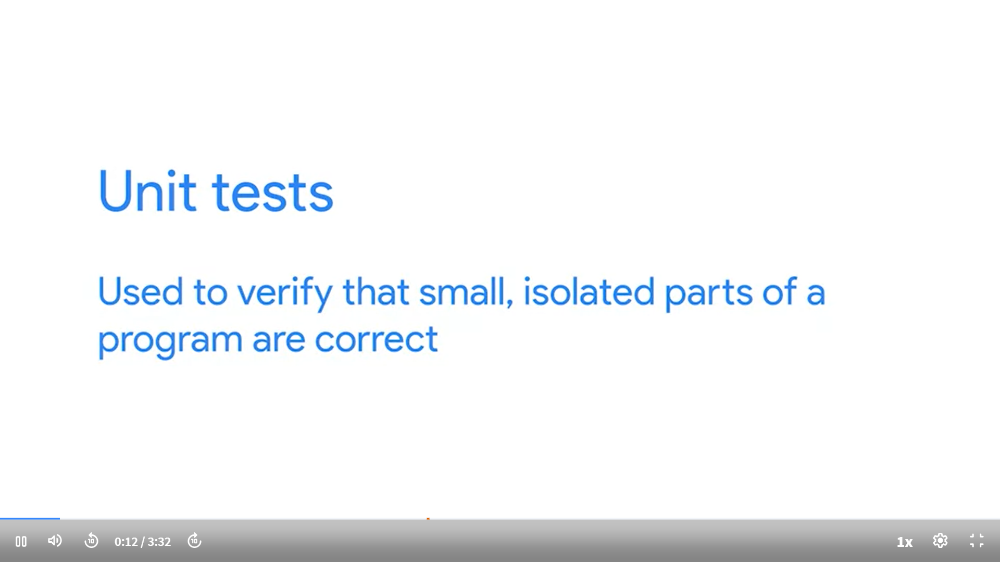

- Most important part of unit test is ISOLATION
- Test should never modify the production environment

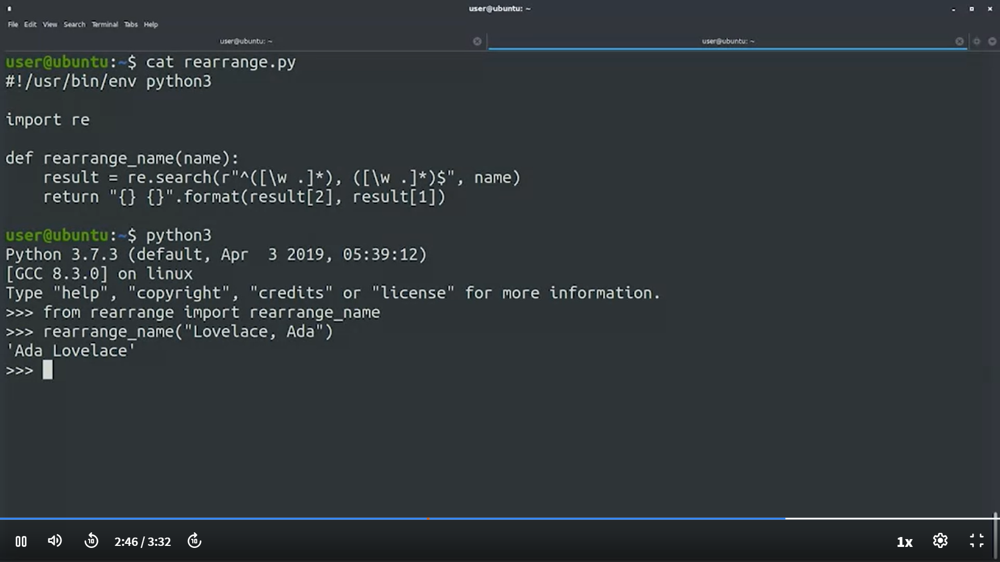

In [ ]:
# Do not run this code
# This cell is for reference only

#!/usr/bin/env python3
import re
def rearrange_name(name):
  result = re.search(r"^([\w .]*), ([\w .]*)$", name)
  return "{} {}".format(result[2], result[1])
from rearrange import rearrange_name


rearrange_name("Lovelace, Ada")  

### Review: Writing unit tests in python
This reading contains the code used in the instructional videos from 
Writing Unit Tests in Python

Introduction
This follow-along reading is organized to match the content in the video that follows. It contains the same code shown in the next video. These code blocks will provide you with the opportunity to see how the code is written, allow you to practice running it, and can be used as a reference to refer back to. 

You can follow along in the reading as the instructor discusses the code or review the code after watching the video.

In [ ]:
# DO NOT RUN THIS CELL
# This cell is for reference only.

#!/usr/bin/env python3

import re

def rearrange_name(name):
  result = re.search(r"^([\w .]*), ([\w .]*)$", name)
  return "{} {}".format(result[2], result[1])



#!/usr/bin/env python3

import unittest

from rearrange import rearrange_name

class TestRearrange(unittest.TestCase):
    
  def test_basic(self):
    testcase = "Lovelace, Ada"
    expected = "Ada Lovelace"
    self.assertEqual(rearrange_name(testcase), expected)

# Run the tests
unittest.main()


# CLI command
chmod +x rearrange_test.py 
./rearrange_test.py 

Note:
- We usually create a separate file for unit tests, and not inside of the code we made. Example:
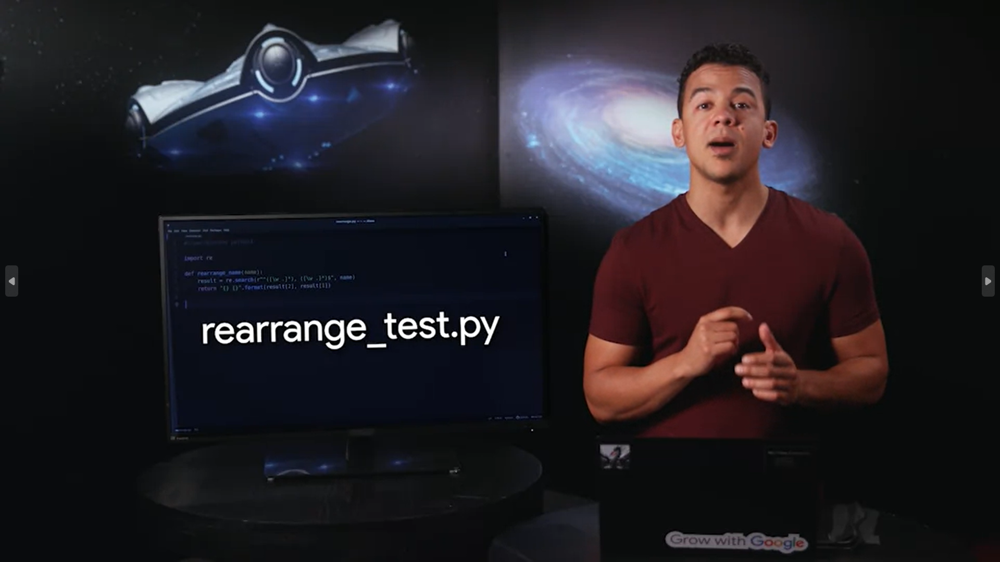

- We use the 'from [] import' syntax. Example:
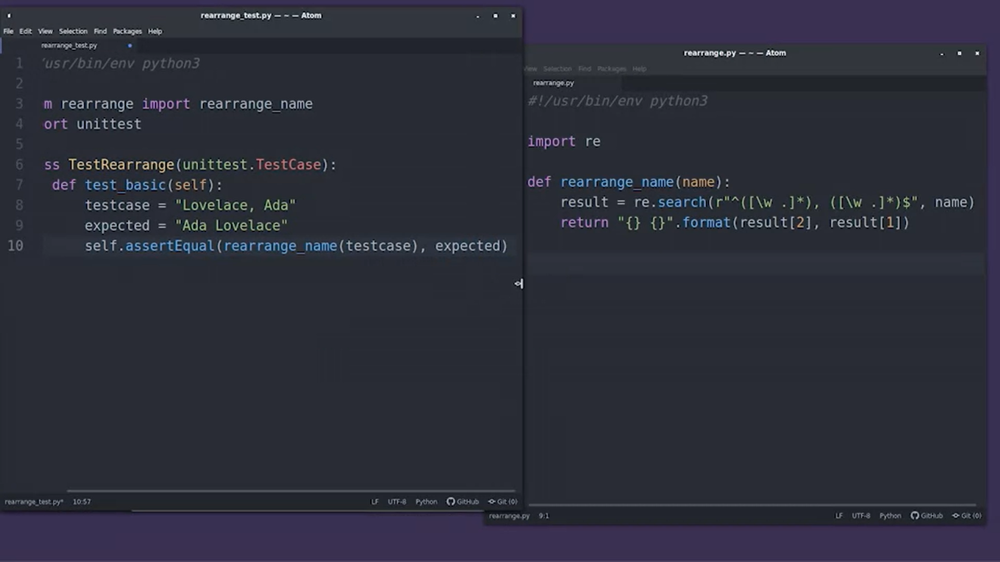
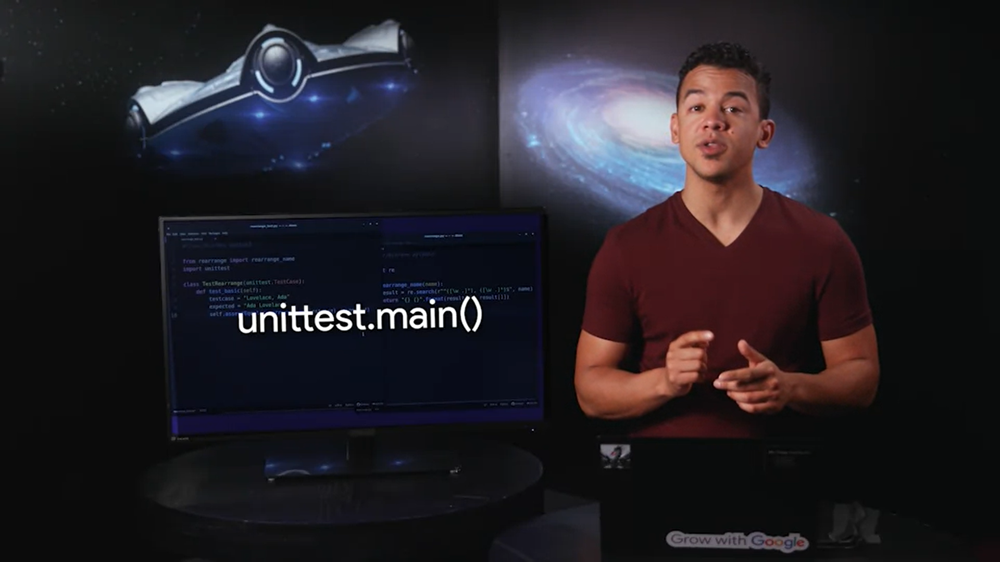
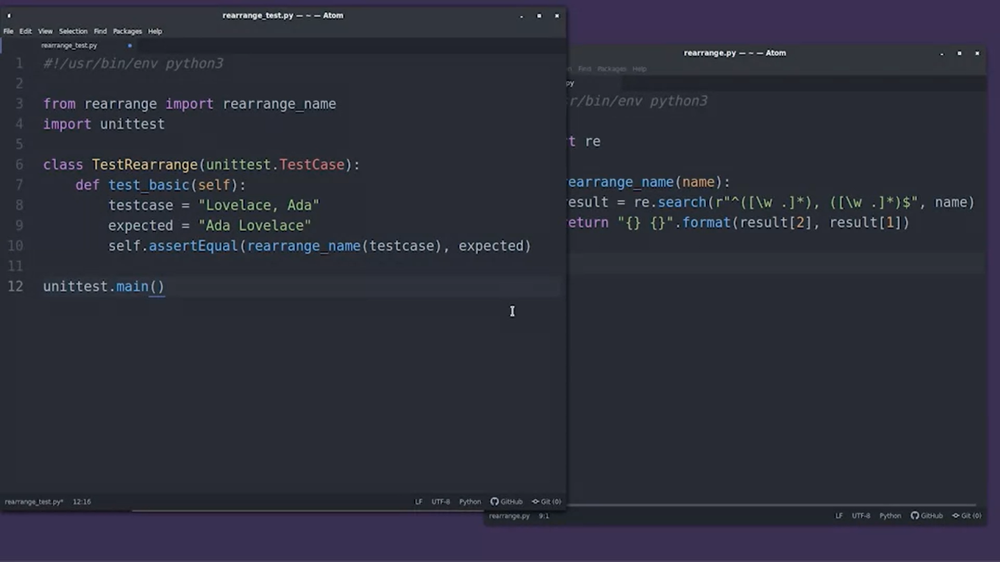
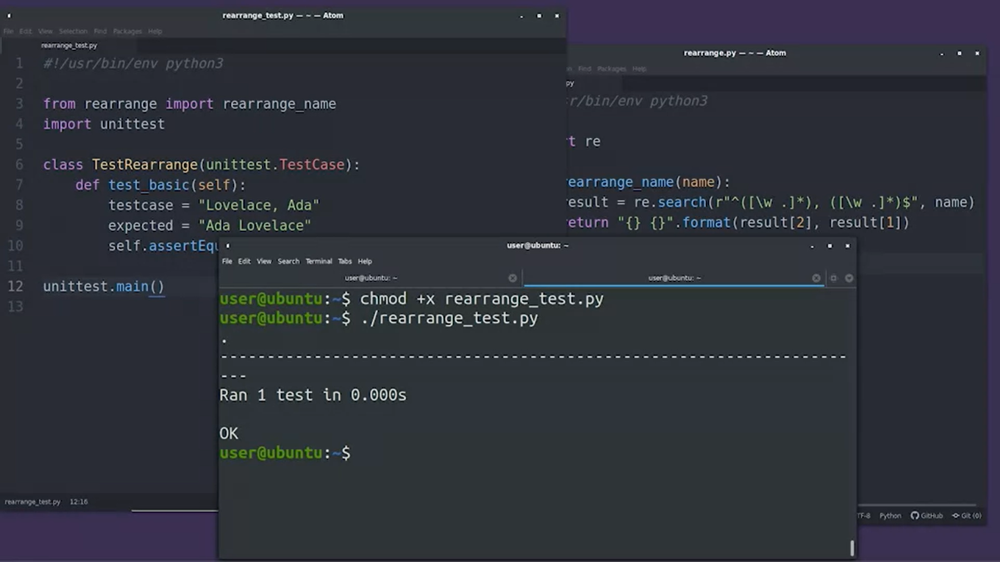

### Review: Edge cases
This reading contains the code used in the instructional videos from 
Edge Cases

Introduction
This follow-along reading is organized to match the content in the video that follows. It contains the same code shown in the next video. These code blocks will provide you with the opportunity to see how the code is written, allow you to practice running it, and can be used as a reference to refer back to. 

You can follow along in the reading as the instructor discusses the code or review the code after watching the video.

In [ ]:
# Rearrange_Name Test
def test_empty(self):
  testcase = ""
  expected = ""
  self.assertEqual(rearrange_name(testcase), expected)
  
# CLI
./rearrange_test.py 

# Rearrange_Name Code
#!/usr/bin/env python3

import re

def rearrange_name(name):
  result = re.search(r"^([\w .-]*), ([\w .-]*)$", name)
  if result is None:
    return ""
  return "{} {}".format(result[2], result[1])

# CLI
./rearrange_test.py 

### Empty test
- added Empty Test to the unit test
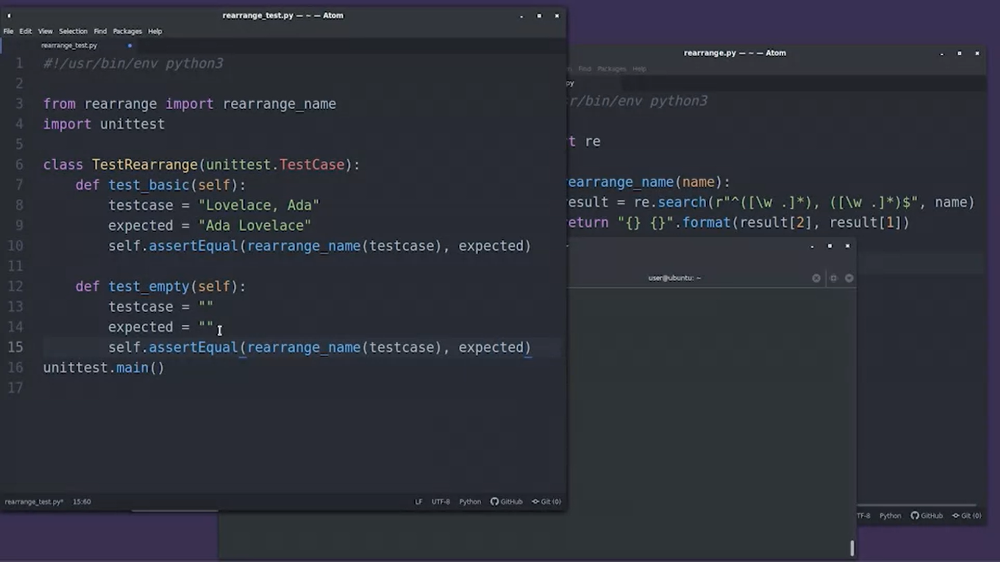
- One Error:

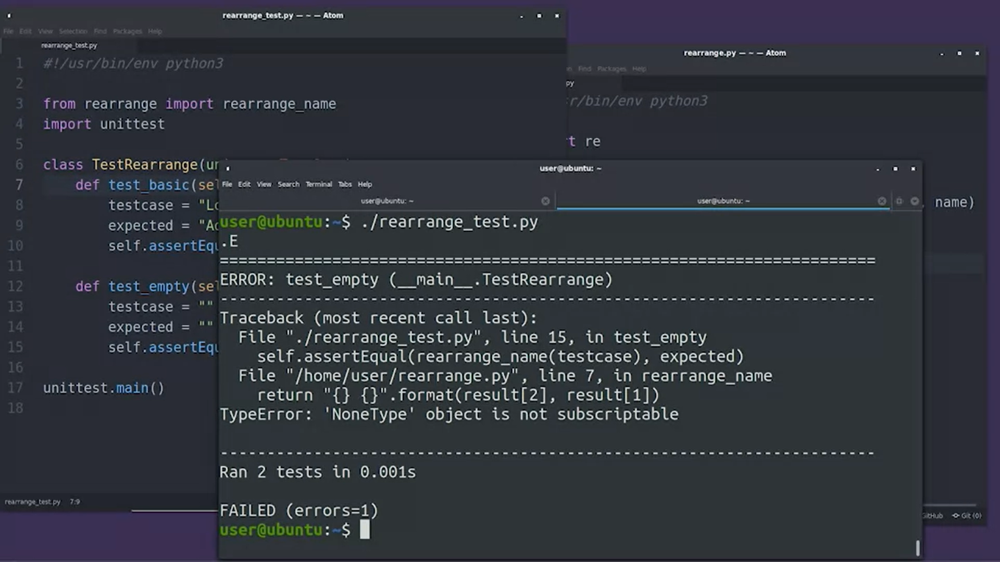


### Edge Cases

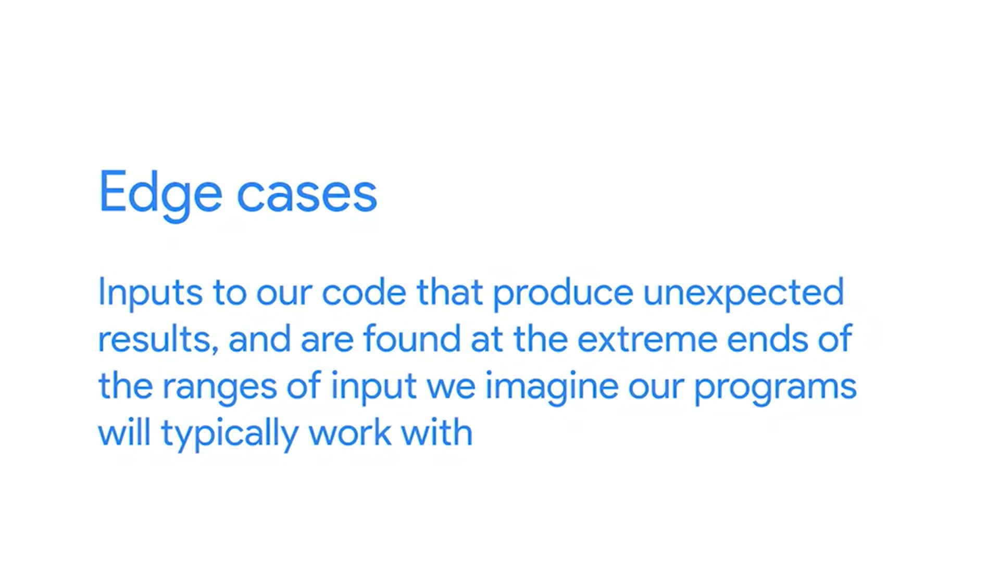

- Therefore, we handle this error by editing the main code:
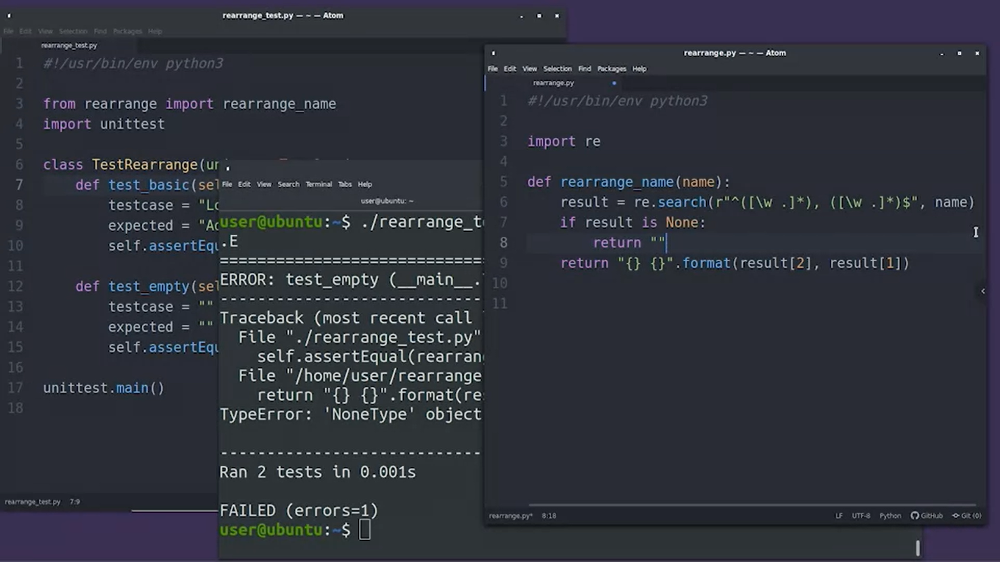

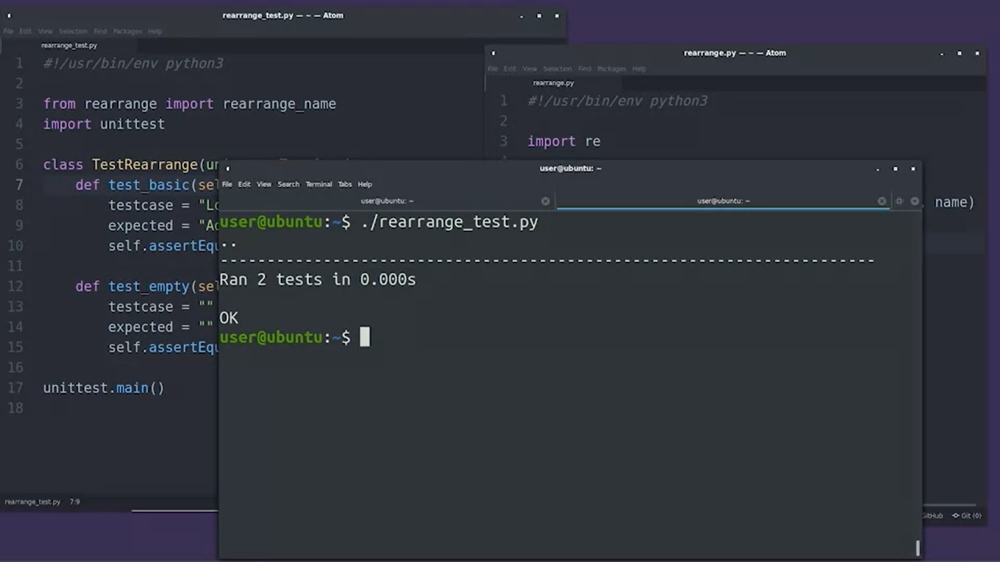
-------- Remember ----------
- It is bad for automation to fail silently. So Edge Cases are important.

### Additional Test Cases
These code blocks will provide you with the opportunity to see how the code is written, allow you to practice running it, and can be used as a reference to refer back to. 

In [ ]:
#Do not run this line
# This cell is for reference only
from rearrange import rearrange_name
import unittest

class TestRearrange(unittest.TestCase):
  
  def test_basic(self):
    testcase = "Lovelace, Ada"
    expected = "Ada Lovelace"
    self.assertEqual(rearrange_name(testcase), expected)

  def test_empty(self):
    testcase = ""
    expected = ""
    self.assertEqual(rearrange_name(testcase), expected)

  def test_double_name(self):
    testcase = "Hopper, Grace M."
    expected = "Grace M. Hopper"
    self.assertEqual(rearrange_name(testcase), expected)

  def test_one_name(self):
    testcase = "Voltaire"
    expected = "Voltaire"
    self.assertEqual(rearrange_name(testcase), expected)

# Run the tests
unittest.main()


Exercise for Unittest: 
C2M5L2_Unit_Tests_and_Edge_Cases-V3.ipynb

# White-box Test and Black-box Test

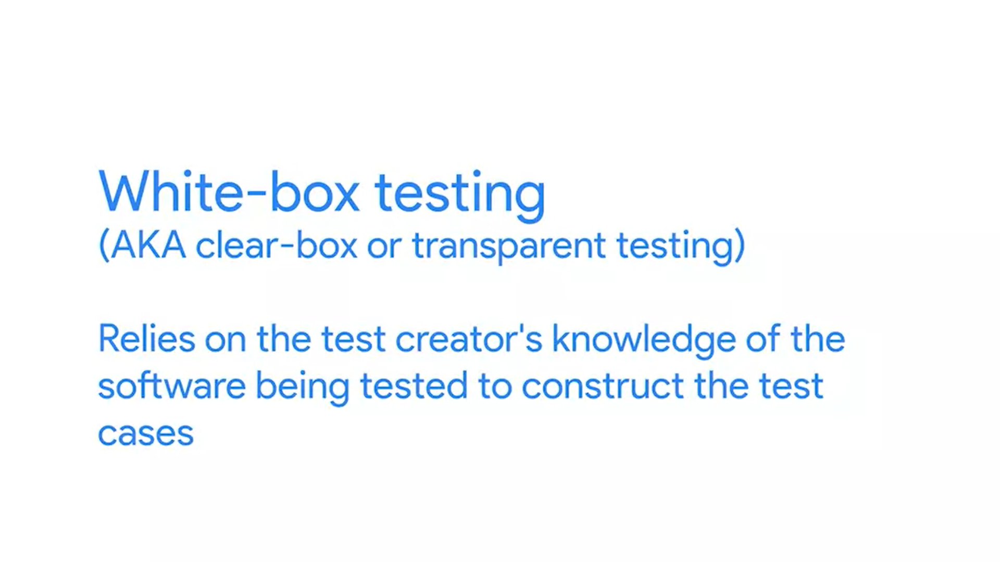
- Are usually done after the code is written.

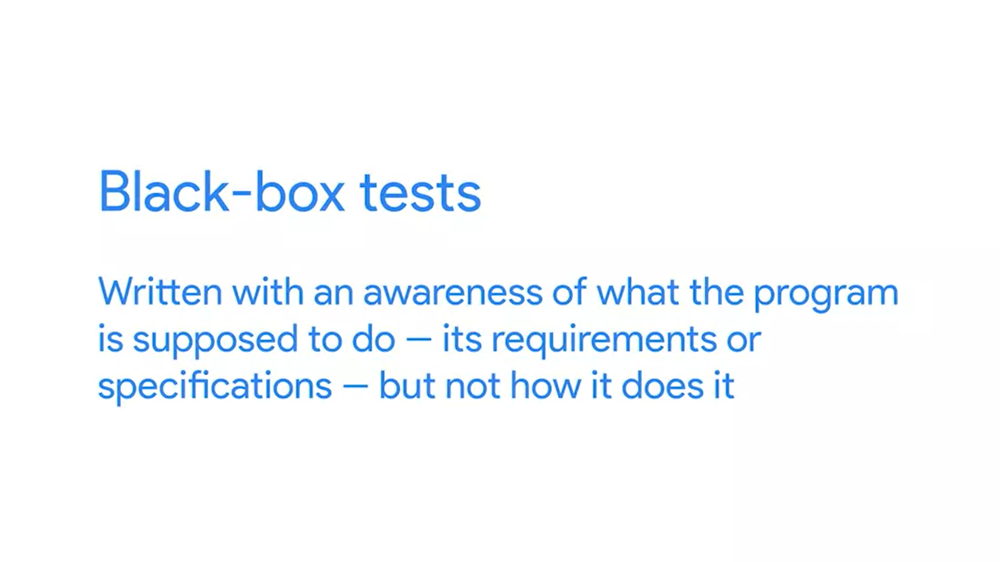
- Are usually done before the code is written.